In [1]:
import os
import numpy as np
import argparse
from tqdm import tqdm

import librosa
import soundfile as sf

from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
# Import the audio file

# input_filename = '/home/justin/MAS_Project/data/test/00/3263A1.wav'
input_path = '/home/justin/MAS_Project/data/test/00/'
# filename = '3841A1.wav'
# output_path = '/home/justin/MAS_Project/data/test/00/test/'
# input_path = 'input/'
filename = '3263A1'
extension = '.wav'
output_path = 'output/'

def load_file(input_filename, mono=True, sr=44100): #sr=22050):
    # if mono is true, returns samples of shape (2, n, )
    # else returns samples of shape (n, )
    # sample rate refers to number of samples per second: default selected by None, librosa default is 22050
    x, sr = librosa.load(input_filename, mono=mono, sr=sr)
    return x, sr

x, sr = load_file(input_path + filename + extension)

0.0 300.0 13230000
13230000
13230000
0.0 4.0 176400
176400
176400


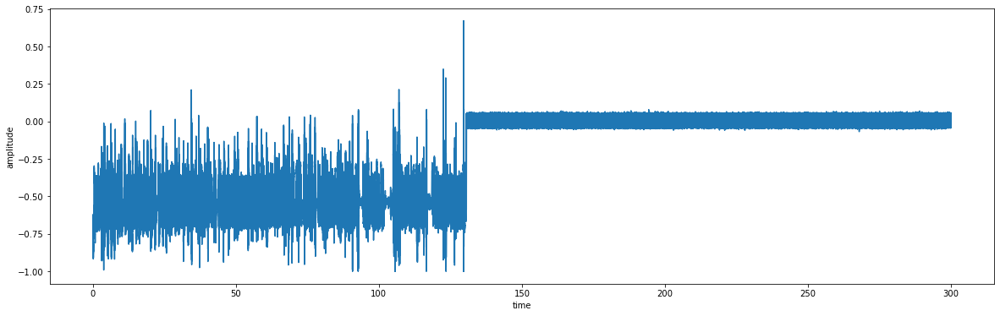

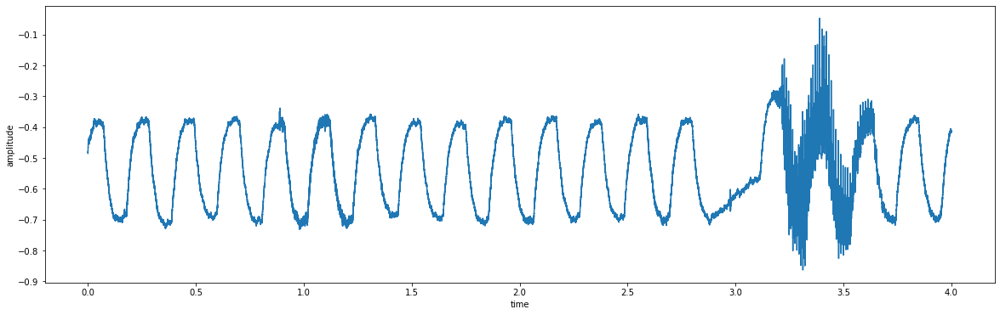

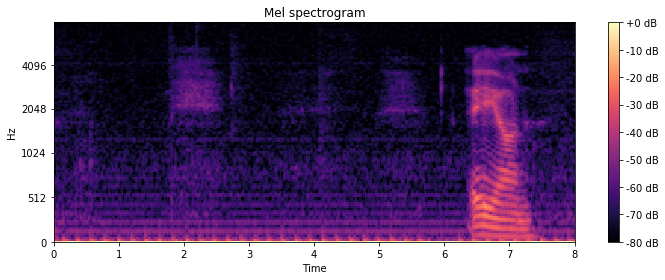

In [3]:
# function for plotting the wave in seconds instead of frames

def plot_wav(time_series,sample_rate):
    plt.figure(figsize=(20, 6))
    plt.xlabel('time')
    plt.ylabel('amplitude')
    print(0., len(time_series)/sample_rate, len(time_series))
    print(len(time_series))
    t = np.linspace(0., len(time_series)/sample_rate, len(time_series))
    print(len(t))
    plt.plot(t, time_series)
    return plt
    
plot_wav(x, sr)

START = 51  #121#11 
DUR = 4     #2#5

def plot_xvis(x, start, dur, onset_times, sr):
    end = start + dur
    x_vis = x[start*sr:end*sr]
    plot_wav(x_vis, sr)
    for onset in onset_times:
        if onset < start:
            continue
        elif onset > end:
            break
        plt.axvline(x=onset-start)
        
plot_xvis(x, START, DUR, [], sr)

# Sine wave noise removal: spectogram

def get_S(x, sr):
    x = np.array(x)
    return librosa.feature.melspectrogram(y=x, sr=sr, n_mels=128, fmax=8000)

def plot_ms(x, sr):
    import librosa.display
    S = get_S(x, sr)
    plt.figure(figsize=(10, 4))
    librosa.display.specshow(librosa.power_to_db(S, ref=np.max), y_axis='mel', fmax=8000, x_axis='time')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel spectrogram')
    plt.tight_layout()
    plt.show()
    
def plot_msvis(x, start, dur, sr):
    end = start + dur
    x_vis = x[start*sr:end*sr]
    plot_ms(x_vis, sr)
    
# plot_ms(x)
plot_msvis(x, START, DUR, sr)

In [4]:
# STEP 1: cut 
def cut_recording(x, sr):
    x = cut(x, cut_by_integration(x, width=sr), sr)
    plot_wav(x, sr)
    return x

def cut(x, endtime, sr):
    print("cutting at " + str(endtime))
    return x[:int(endtime+0.5)*sr]

def cut_by_integration(x, width=sr):
    # integrate in a sliding window area of interest, the magnitude gives us a value to judge where to cut
    length = len(x)
    seconds = int(length/sr)
    windows = range(0, length, sr)
    intx = [abs(sum(x[a: a+sr])) for a in windows]
    plt.figure()
    plt.plot(intx)
    s = get_S(t, sr)
    rms = librosa.feature.rms(S = s)
    plt.figure()
    plt.plot(rms[0])
    for i in range(seconds-1, 0, -1):
        if intx[i] > 200: # cutoff
            print("cutoff reached")
            return i+1 if i+1 < seconds-1 else seconds-1
    
    return -1

# x = cut_recording(x, sr)
# cut_recording(x, sr)

-0.23329706
0.0 300.0 13230000
13230000
13230000


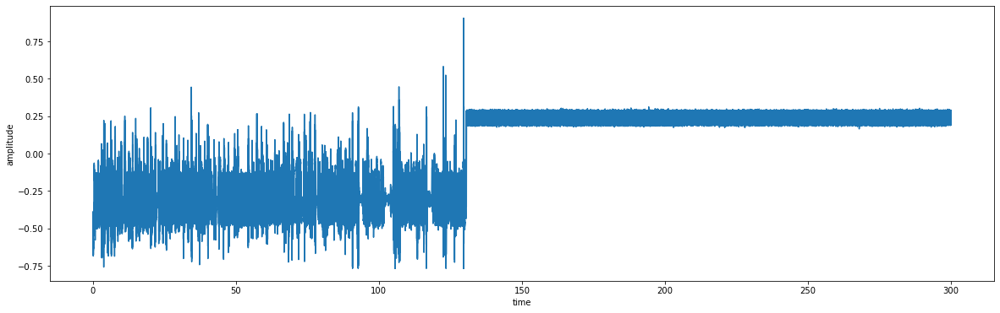

In [5]:
# STEP 2: Normalise the wave, by removing the DC Offset present in recording. 
# source: https://manual.audacityteam.org/man/dc_offset.html
# Audacity's DC removal method performs a calculation to make the average positive and negative sample values equal.

def dc_removal(x, sr):
    x_mean = np.mean(x)
    print(x_mean)
    x = [e - x_mean for e in x]
    plot_wav(x, sr)
    return x

x = dc_removal(x, sr)


0.0 6.0 264600
264600
264600


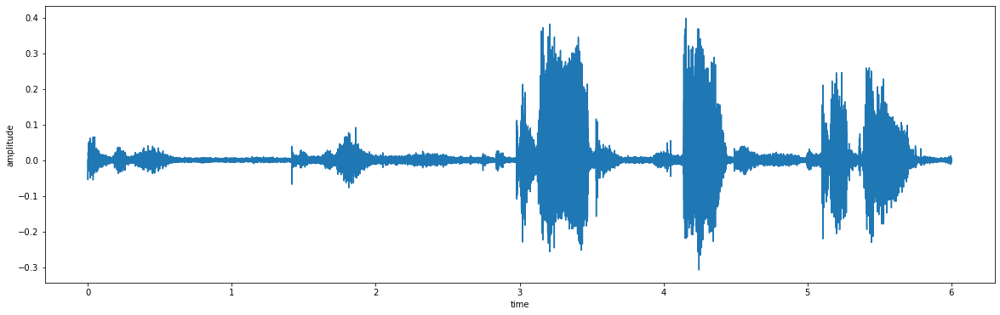

In [6]:

def high_pass_filter(x, sr, cutOff = 500):
    from scipy import signal

    #Creation of filter
    nyq = 0.5 * sr
    N  = 5    # Filter order
    fc = cutOff / nyq # Cutoff frequency normal
    b, a = signal.butter(N, fc, btype='high') # high pass filter
    
    #Apply the filter
    tempf = signal.filtfilt(b, a, x)

    return tempf

normal_t = high_pass_filter(x, sr, cutOff=20)
t = high_pass_filter(x, sr, cutOff=300)
plot_xvis(t, 0, 6, [], sr)

before: len =  231
now, sounds:  96
Processed up to  861
Processed up to  1722
Processed up to  2583
Processed up to  3445
Processed up to  4306
Processed up to  5167
Processed up to  6029
Processed up to  6890
Processed up to  7751
Processed up to  8613
Processed up to  9474
Processed up to  10335
Processed up to  11197
Processed up to  12058
Processed up to  12919


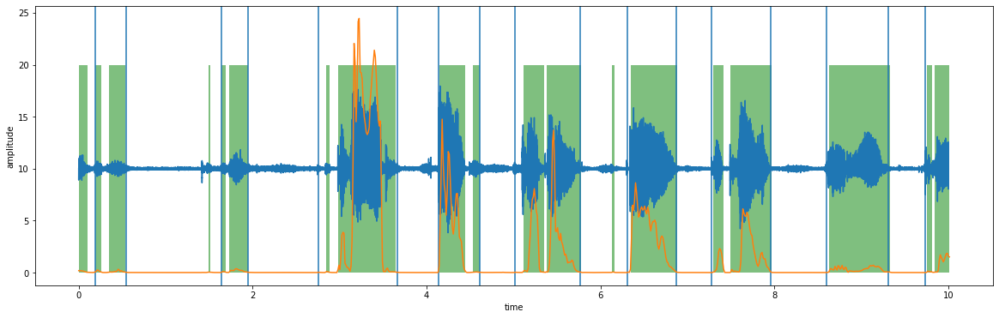

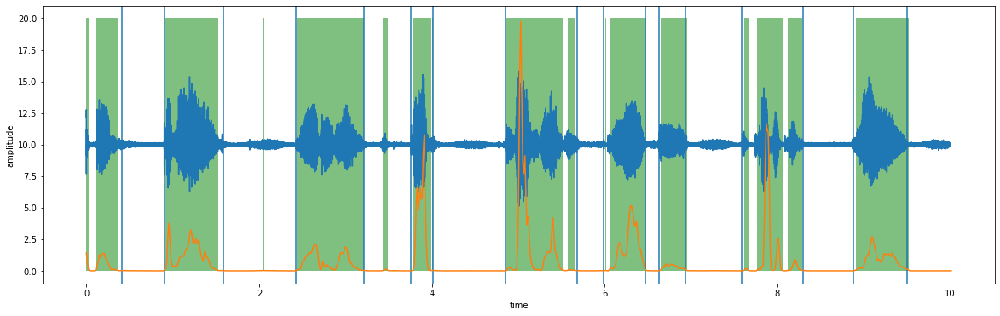

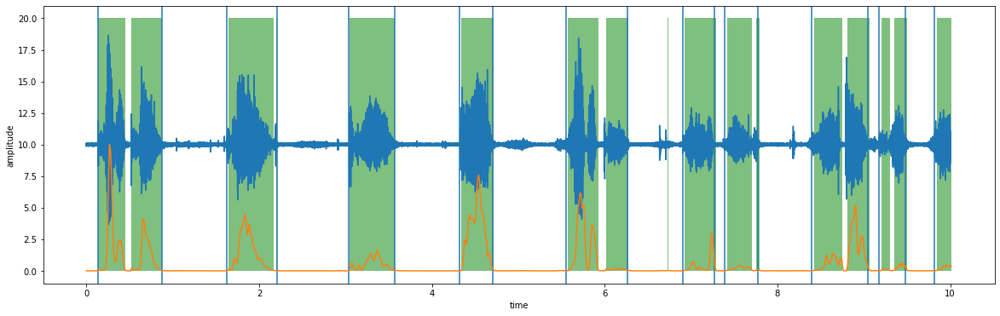

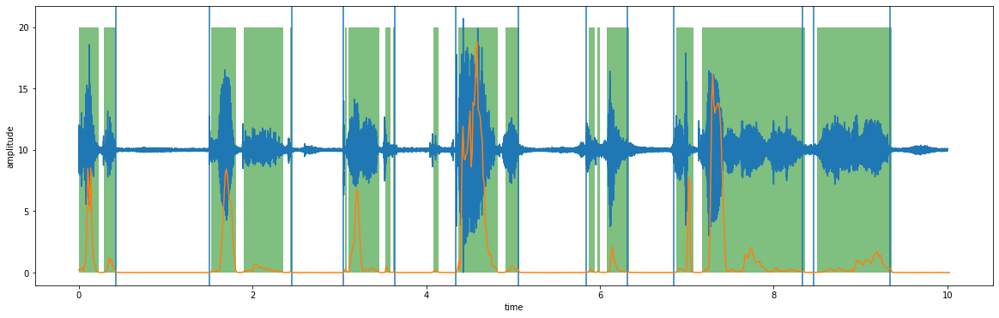

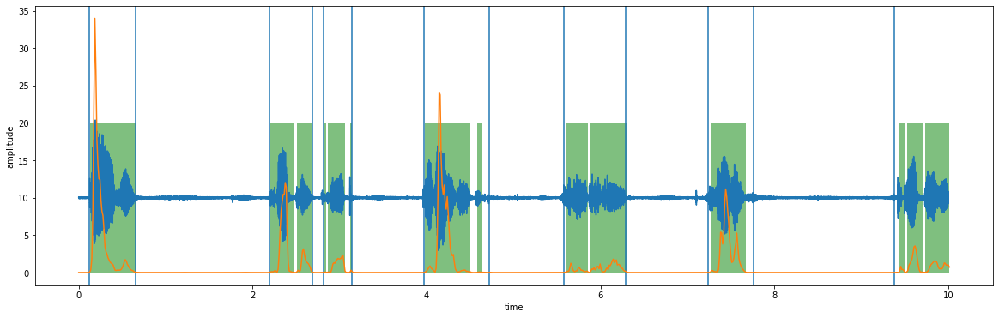

...

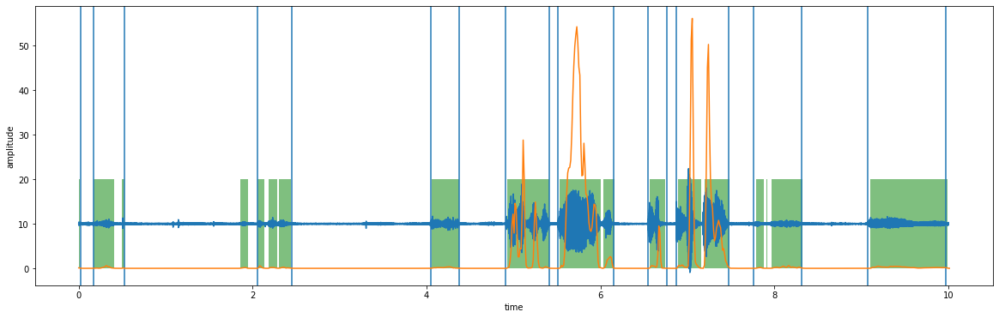

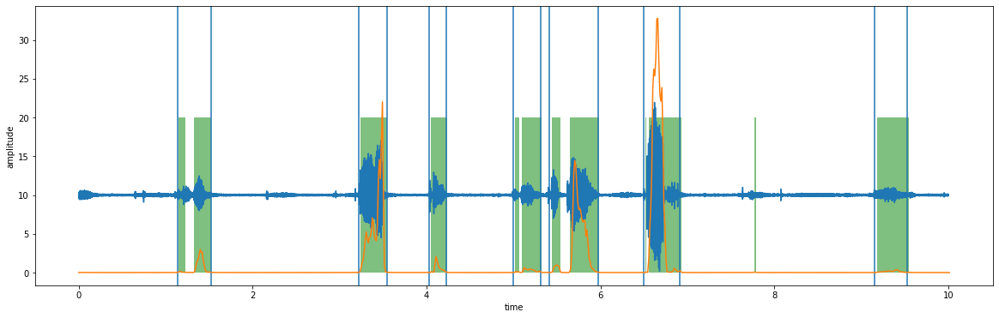

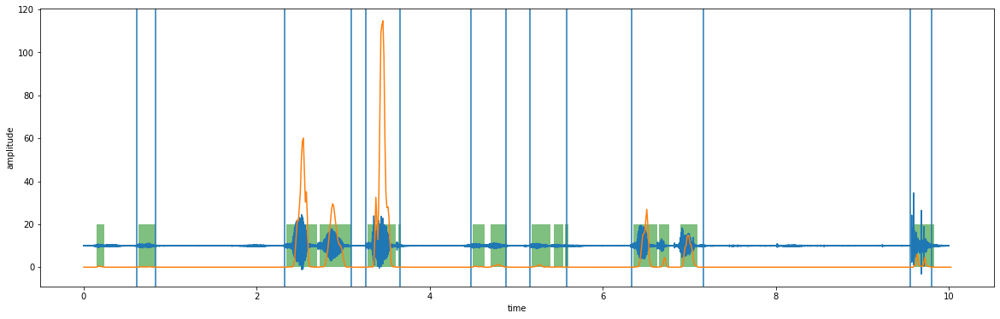

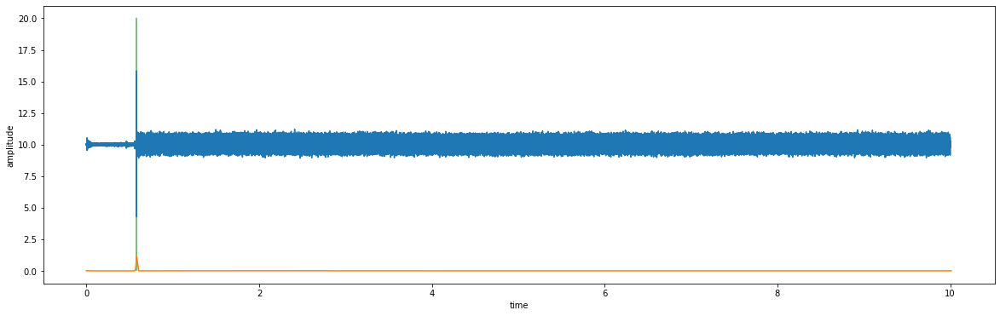

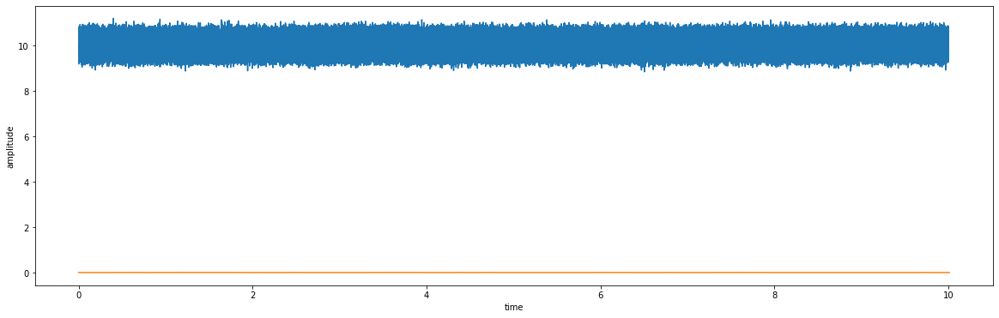

In [13]:
# Consistency check for above method
nstart = 0
ndur = 10

def preprocess(t, sr):
    s = get_S(t, sr)
    rms = librosa.feature.rms(S = s)
    threshold =  np.heaviside(rms[0] - 0.025,1)
    
    i = 0
    silence = (threshold[i] == 1.0)
    sounds = []
    curr_sound = []
    frames = []
    curr_frame = []
    for i in range(1, len(threshold)):
        if threshold[i] == 1.0 and threshold[i-1] < 1.0:
            #start of sound
            if not curr_sound:
                curr_sound.append(i*512/sr)
                curr_frame.append(i)
        elif threshold[i] == 0.0 and threshold[i-1] > 0.0:
            #end of sound
            if curr_sound:
                curr_sound.append(i*512/sr)
                sounds.append(curr_sound)
                curr_sound = []
                curr_frame.append(i)
                frames.append(curr_frame)
                curr_frame = []
    # apply minimum length of 0.1 seconds for silence
    print("before: len = ", len(sounds))
    i = 1
    min_len = 0.1
    while i < len(sounds):
        if sounds[i][0]-sounds[i-1][1] < min_len:
            # this silence is too short
            sounds[i-1][1] = sounds[i][1]
            sounds.pop(i)
            frames[i-1][1] = frames[i][1]
            frames.pop(i)
            i -= 1
        i += 1
        
    i = 1
    while i < len(sounds):
        if sounds[i][1] - sounds[i][0] < min_len:
            # this silence is also too short
            sounds.pop(i)
            frames.pop(i)
            i -= 1
        i += 1

    print("now, sounds: ", len(sounds))
    return t, rms, threshold, sounds, frames

def test_rms(t, rms, threshold, sounds, sr, nstart=0, ndur=5):
    # plot_xvis(t, nstart, ndur, [], sr)
    t_vis = t[nstart*sr:(nstart+ndur)*sr]
    t_vis = [20*a + 10 for a in t_vis]
    plt.figure(figsize=(20, 6))
    plt.xlabel('time')
    plt.ylabel('amplitude')
    teess = np.linspace(0., len(t_vis)/sr, len(t_vis))
    plt.plot(teess, t_vis)
    
#     print(sounds)
    
    ssounds = np.array(sounds)
    ssounds = ssounds.flatten()
    for onset in ssounds:
        if onset < nstart:
            continue
        elif onset > nstart+ndur:
            break
        plt.axvline(x=onset-nstart)
    
    vis_start = int(nstart*(sr/512))
    vis_end = int((nstart+ndur)*(sr/512))
    
    rms_threshold_vis = threshold[vis_start:vis_end]
    rms_vis = rms[0][vis_start:vis_end]
    print("Processed up to ", vis_end)
    tees = np.linspace(0., len(rms_vis)/int(sr/512), len(rms_vis))
    plt.plot(tees, rms_vis)
    plt.fill_between(tees, 0, 20, where=rms_threshold_vis > 0,facecolor='green', alpha=0.5)
    plt.show

    
t, rms, threshold, ssounds, frames = preprocess(t, sr)
for i in range(0, int(len(t)/sr), ndur):
    test_rms(t, rms, threshold, ssounds, sr, nstart=i, ndur=ndur)
    if i > 130:
        break

In [10]:
import IPython.display as ipd
print(sr)
ipd.Audio(t, rate=sr)

44100


In [15]:
# import ffmpeg

# for i,s in enumerate(ssounds):
#     stream = ffmpeg.input(input_path + filename + extension)
#     stream.trim(start=s[0], end=s[1])
#     stream.output(output_path + filename + "_{}".format(i))
#     stream.run()
#     if i == 1:
#         break

print(frames[:10])
print(frames[-10:])

[[16, 47], [141, 168], [237, 316], [356, 397], [432, 497], [543, 592], [627, 685], [741, 802], [838, 897], [939, 998]]
[[9941, 9989], [10034, 10070], [10263, 10295], [10389, 10407], [10536, 10602], [10617, 10651], [10721, 10756], [10780, 10817], [10881, 10953], [11159, 11180]]
